# Figure 4 - what drives concentration fluctuations? - continue

<script src="https://polyfill.io/v3/polyfill.min.js?features=es6"></script>
<script id="MathJax-script" async src="https://cdn.jsdelivr.net/npm/mathjax@3/es5/tex-mml-chtml.js"></script>

Saintillan and Shelly (2008) identifies source field $\nabla \cdot (c\boldsymbol{n})$ as the driving force of giant number fluctuations in pusher suspensions. The equation they found was a direct consequence of a probability conservation equation, with microswimmer velocity modelled by the sum of self-propelling, flow advection and diffusion:
$$ \dot{x}=U_0\boldsymbol{p}+\boldsymbol{u}-D\nabla_x(\ln{\Phi})$$
and the resulting conservation equation is:
$$ \frac{\partial c}{\partial t} + \boldsymbol{u}\cdot \nabla_xc-D\nabla_x^2c=-U_0\nabla\cdot(c\boldsymbol{n})$$

Below, we take the example of 02042020/80-1 data, and analyze the terms $\frac{\partial c}{\partial t}$, $\frac{\partial c}{\partial t}+\boldsymbol{u}\cdot \nabla_xc$ and $-U_0\nabla\cdot(c\boldsymbol{n})$, hoping to find the correlations between them. 

The time interval for calculating $\frac{\partial c}{\partial t}$ is chosen to be 10 frames, according to the autocorrelation analysis below.
<img src="https://zloverty.github.io/research/DF/img/intensity_autocorr/80.png" height=200px>

In [3]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from skimage import io
import os
import corrLib as cl
import matplotlib
import myImageLib as mil

In [1]:
# figure initializing presets
presets = {}
presets['1-column-2-panel'] = (1.25, 1.57, 157)
presets['1-column-1-panel'] = (1.25, 3.2, 157)
h, w, dpi = presets['1-column-2-panel']

In [4]:
# matplotlib configs

# FONT
matplotlib.rcParams['font.family'] = 'serif'
matplotlib.rcParams['font.size'] = 8
matplotlib.rcParams['text.usetex'] = True 

# FIGURE
matplotlib.rcParams['figure.figsize'] = w, h
matplotlib.rcParams['figure.dpi'] = dpi

# AXES
matplotlib.rcParams['axes.labelpad'] = 1.0
matplotlib.rcParams['axes.labelsize'] = 'small'
matplotlib.rcParams['axes.linewidth'] = 0.5

# TICKS
matplotlib.rcParams['xtick.labelsize'] = 'small'
matplotlib.rcParams['xtick.direction'] = 'in'
matplotlib.rcParams['xtick.minor.visible'] = True
matplotlib.rcParams['xtick.top'] = True
matplotlib.rcParams['xtick.major.size'] = 2.5
matplotlib.rcParams['xtick.minor.size'] = 1.6

matplotlib.rcParams['ytick.labelsize'] = 'small'
matplotlib.rcParams['ytick.direction'] = 'in'
matplotlib.rcParams['ytick.minor.visible'] = True
matplotlib.rcParams['ytick.right'] = True
matplotlib.rcParams['ytick.major.size'] = 2.5
matplotlib.rcParams['ytick.minor.size'] = 1.6

# LEGEND
matplotlib.rcParams['legend.labelspacing'] = 0.2
matplotlib.rcParams['legend.handlelength'] = 1
matplotlib.rcParams['legend.fontsize'] = 'small'
matplotlib.rcParams['legend.handletextpad'] = 0.2
matplotlib.rcParams['legend.columnspacing'] = 0.5
matplotlib.rcParams['legend.frameon'] = False

In [22]:
# generate subtraction field
folder = r'E:\moreData\02042020\80-1\bp'
interval = 100
n0 = 0
n1 = 0 + interval
I0 = io.imread(os.path.join(folder, '{:04d}.tif'.format(n0)))
I1 = io.imread(os.path.join(folder, '{:04d}.tif'.format(n1)))
dif = I1.astype('float32') - I0.astype('float32')

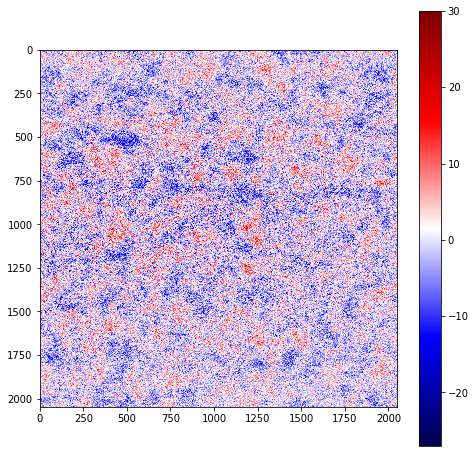

In [20]:
plt.figure(figsize=(8, 8))
plt.imshow(dif, cmap='seismic')
plt.colorbar()

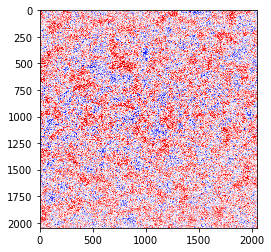

In [23]:
iL = [10, 20, 50, 100, 200, 300, 400, 500, 600, 700, 800, 900]
n0 = 0
folder_out = r'E:\moreData\02042020\subtraction\80-1_txt'
folder_out_img = r'E:\moreData\02042020\subtraction\80-1_img'
for i in iL:    
    n1 = 0 + i
    I0 = io.imread(os.path.join(folder, '{:04d}.tif'.format(n0)))
    I1 = io.imread(os.path.join(folder, '{:04d}.tif'.format(n1)))
    dif = I1.astype('float32') - I0.astype('float32')
    np.savetxt(os.path.join(folder_out, '{:04d}-{:04d}.txt'.format(n0, n1)), dif)
    plt.imshow(dif, cmap='seismic')
    plt.savefig(os.path.join(folder_out_img, '{:04d}-{:04d}.png'.format(n0, n1)))

In [27]:
pivData = pd.read_csv(r'E:\moreData\02042020\piv_result_50\80-1\0000-0001.csv')
img = io.imread(os.path.join(folder, '0000.tif'))
c, v, divcn, divcv, divv = cl.div_field(img, pivData, 50, 25)

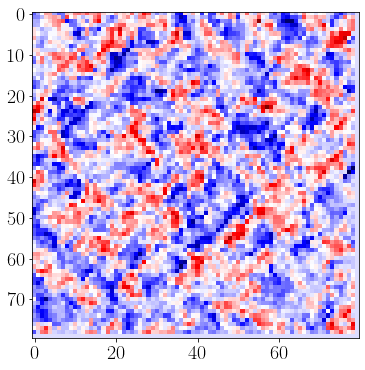

In [64]:
plt.imshow(divv, cmap='seismic')

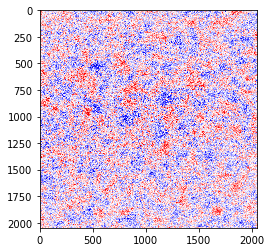

In [40]:
iL = np.linspace(10, 990, 100)
CL = []
n0 = 0
for i in iL:
    interval = np.floor(i)
    n1 = int(n0 + interval)
    I0 = io.imread(os.path.join(folder, '{:04d}.tif'.format(n0)))
    I1 = io.imread(os.path.join(folder, '{:04d}.tif'.format(n1)))
    dif = I1.astype('float32') - I0.astype('float32')
    np.savetxt(os.path.join(folder_out, '{:04d}-{:04d}.txt'.format(n0, n1)), dif)
    plt.imshow(dif, cmap='seismic')
    plt.savefig(os.path.join(folder_out_img, '{:04d}-{:04d}.png'.format(n0, n1)))
    X, Y, difc = cl.divide_windows(dif, windowsize=[50, 50], step=25)
    difc = difc - difc.mean()
    divv = divv - divv.mean()
    C = (divv * difc).mean() / divv.std() / difc.std()
    CL.append(C)

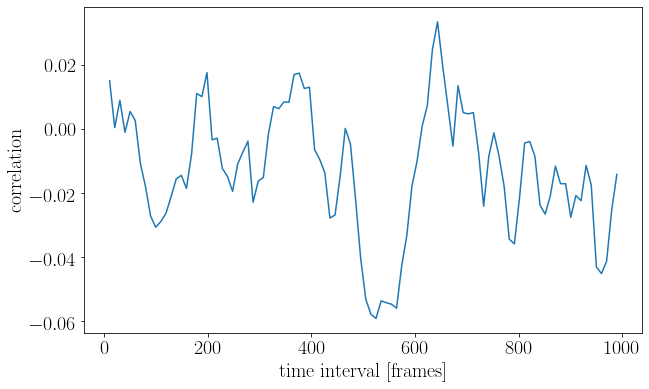

In [45]:
plt.plot(iL, CL)
plt.xlabel('time interval [frames]')
plt.ylabel('correlation')
plt.savefig(r'E:\Github\zloverty.github.io\research\DF\img\appropriate_time_interval\correlation.png', fmt='png')

E:\anaconda\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


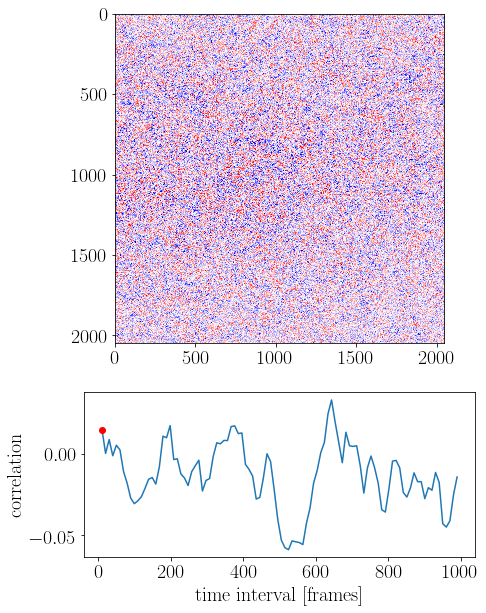

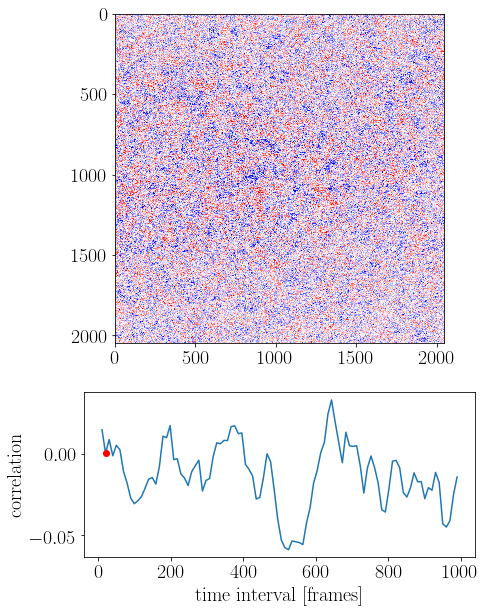

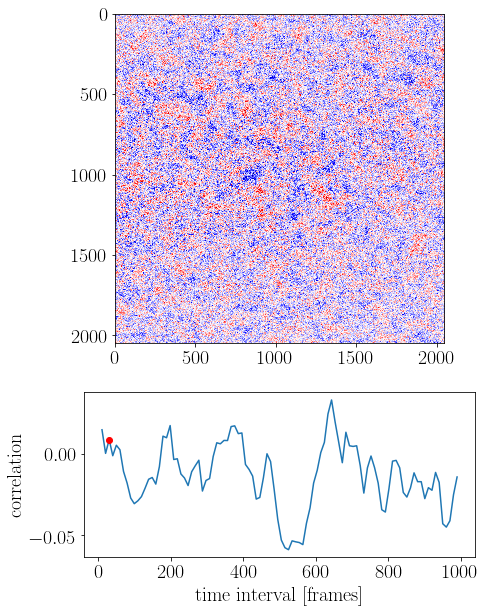

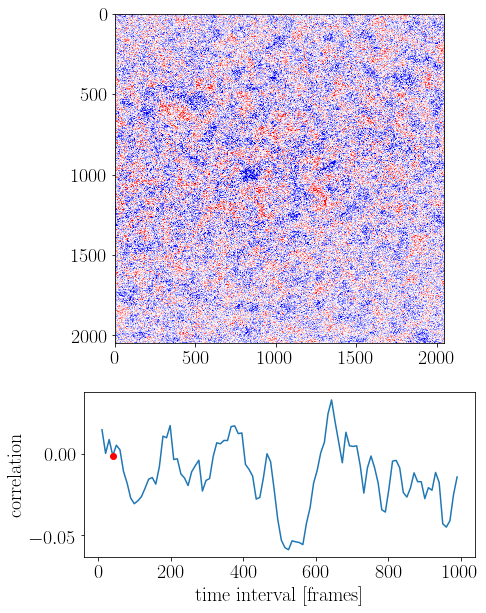

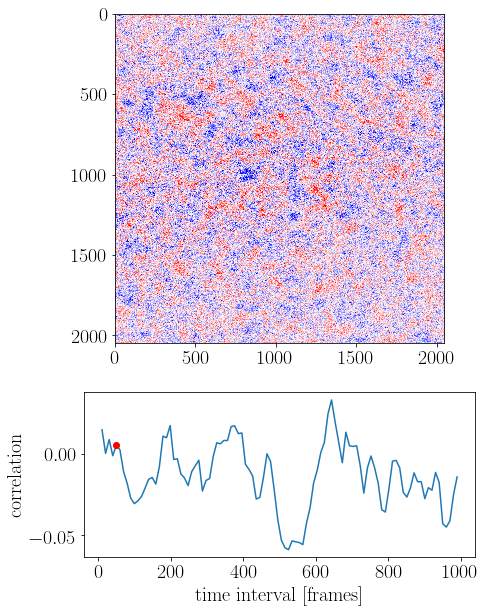

...

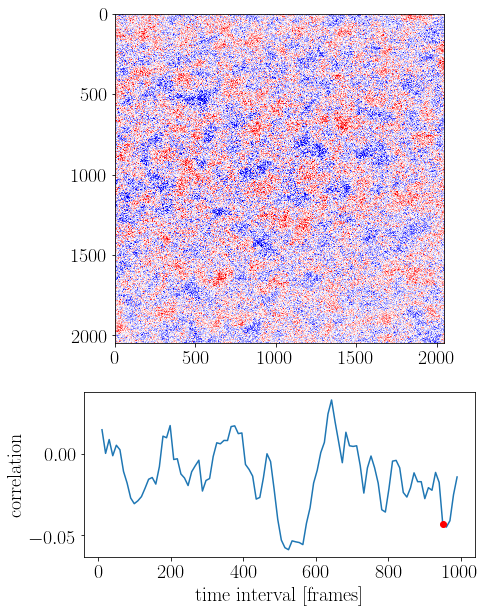

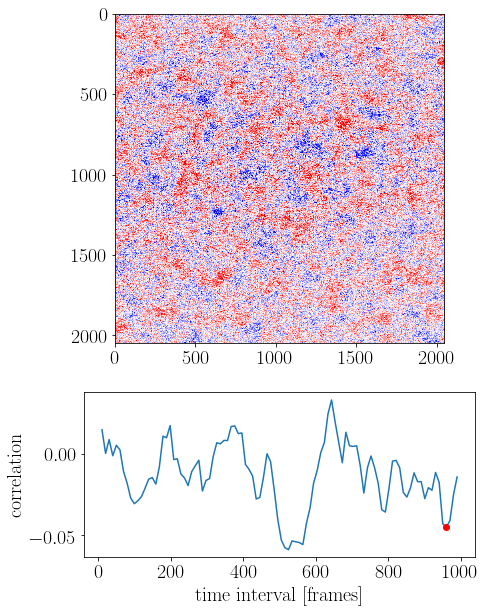

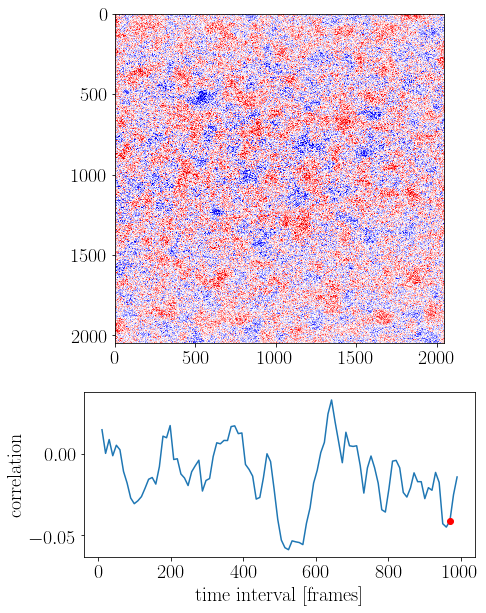

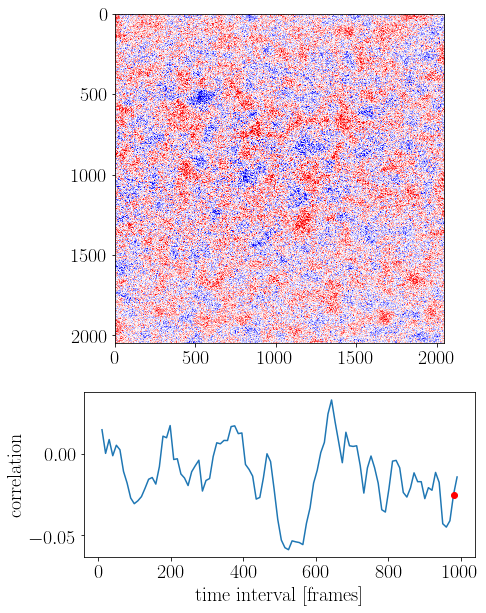

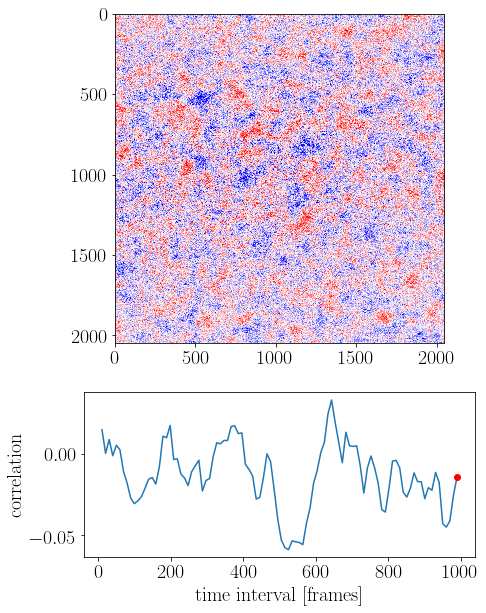

In [63]:
folder = r'E:\moreData\02042020\subtraction\80-1_txt'
folder_out = r'E:\moreData\02042020\subtraction\80-1_time-interval-exp'
l = mil.dirrec(folder, '*.txt')
for num, i in enumerate(l):   
    fig, ax = plt.subplots(nrows=2, ncols=1, figsize=(7, 10), gridspec_kw={'height_ratios': [2, 1]})
    ax[0].imshow(np.loadtxt(i), cmap='seismic')
    ax[1].plot(iL, CL)
    ax[1].plot(iL[num], CL[num], marker='o', color='red')
    plt.xlabel('time interval [frames]')
    plt.ylabel('correlation')
    name = os.path.split(i)[1].split('.')[0]
    plt.savefig(os.path.join(folder_out, name + '.png'))

## Include advection term

In [3]:
folder = r'E:\moreData\02042020\80-1\8-bit'
folder_piv = r'E:\moreData\02042020\piv_result_50\80-1'
interval = 10
n0 = 0
n1 = n0 + interval
I0 = io.imread(os.path.join(folder, '{:04d}.tif'.format(n0)))
I1 = io.imread(os.path.join(folder, '{:04d}.tif'.format(n1)))
X, Y, I0s = cl.divide_windows(I0, windowsize=[50, 50], step=25)
X, Y, I1s = cl.divide_windows(I1, windowsize=[50, 50], step=25)
pivData = pd.read_csv(os.path.join(folder_piv, '0000-0001.csv'))

In [26]:
# generate shift matrices
shiftx = np.zeros(I0s.shape)
shifty = np.zeros(I0s.shape)
for x in range(0, I0s.shape[0]):
    for y in range(0, I0s.shape[1]):
        if x == y - 1:
            shiftx[x, y] = 1
for x in range(0, I0s.shape[0]):
    for y in range(0, I0s.shape[1]):
        if x == y + 1:
            shifty[x, y] = 1
shiftx[0, 0] = 1
shifty[0, 0] = 1

In [14]:
I0s

array([[144.61  , 146.5324, 146.0456, ..., 143.0512, 143.2196, 144.394 ],
       [144.3476, 146.0528, 145.8964, ..., 144.7368, 145.2124, 145.7448],
       [145.2948, 146.6356, 146.4612, ..., 146.3972, 147.2844, 147.5352],
       ...,
       [137.888 , 137.7084, 138.5684, ..., 131.5596, 131.5108, 130.9988],
       [137.5452, 137.904 , 138.4888, ..., 130.7824, 130.3888, 129.7392],
       [138.2472, 138.1268, 138.6836, ..., 128.0108, 129.0112, 129.4924]])

In [27]:
np.matmul(shifty, I0s)

array([[144.61  , 146.5324, 146.0456, ..., 143.0512, 143.2196, 144.394 ],
       [144.61  , 146.5324, 146.0456, ..., 143.0512, 143.2196, 144.394 ],
       [144.3476, 146.0528, 145.8964, ..., 144.7368, 145.2124, 145.7448],
       ...,
       [138.832 , 138.6172, 139.6308, ..., 131.8232, 131.8328, 131.2972],
       [137.888 , 137.7084, 138.5684, ..., 131.5596, 131.5108, 130.9988],
       [137.5452, 137.904 , 138.4888, ..., 130.7824, 130.3888, 129.7392]])

In [28]:
np.matmul(I0s, shiftx)

array([[144.61  , 144.61  , 146.5324, ..., 143.8228, 143.0512, 143.2196],
       [144.3476, 144.3476, 146.0528, ..., 144.8044, 144.7368, 145.2124],
       [145.2948, 145.2948, 146.6356, ..., 146.6228, 146.3972, 147.2844],
       ...,
       [137.888 , 137.888 , 137.7084, ..., 132.2572, 131.5596, 131.5108],
       [137.5452, 137.5452, 137.904 , ..., 131.9024, 130.7824, 130.3888],
       [138.2472, 138.2472, 138.1268, ..., 129.8704, 128.0108, 129.0112]])

In [18]:
ux = np.array(pivData.u).reshape(I0s.shape)
uy = np.array(pivData.v).reshape(I0s.shape)

In [39]:
dcx = I0s - np.matmul(I0s, shiftx)
dcy = I0s - np.matmul(shifty, I0s)
dc = I1s - I0s
adv = dc/interval + ux*dcx/25 + uy*dcy/25

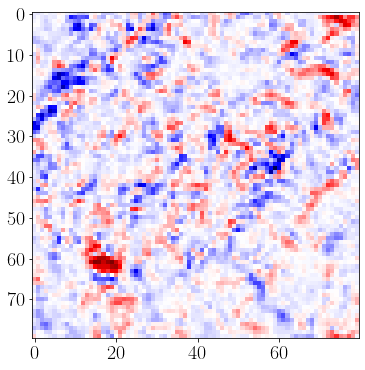

In [40]:
plt.imshow(-adv, cmap='seismic')

In [4]:
c, v, divcn, divcv, divv = cl.div_field(I0, pivData, 50, 25)

In [51]:
# Correlation calculator
corr = ((divv - divv.mean())*(adv - adv.mean())).mean() / divv.std() / adv.std()

In [56]:
# job file generator
c = [20, 40, 60, 80]
n = [1, 2, 3]
for cc in c:
    for nn in n:
        name = '{0}-{1}'.format(cc, nn)
        print('python dc_adv.py ~/Data/02042020/'+name+'/8-bit ~/Data/02042020/piv_result_50/'+name+' ~/Data/02042020/dc+adv/'+name+' 10 &')

python dc_adv.py ~/Data/02042020/20-1/8-bit ~/Data/02042020/piv_result_50/20-1 ~/Data/02042020/dc+adv/20-1 10 &
python dc_adv.py ~/Data/02042020/20-2/8-bit ~/Data/02042020/piv_result_50/20-2 ~/Data/02042020/dc+adv/20-2 10 &
python dc_adv.py ~/Data/02042020/20-3/8-bit ~/Data/02042020/piv_result_50/20-3 ~/Data/02042020/dc+adv/20-3 10 &
python dc_adv.py ~/Data/02042020/40-1/8-bit ~/Data/02042020/piv_result_50/40-1 ~/Data/02042020/dc+adv/40-1 10 &
python dc_adv.py ~/Data/02042020/40-2/8-bit ~/Data/02042020/piv_result_50/40-2 ~/Data/02042020/dc+adv/40-2 10 &
python dc_adv.py ~/Data/02042020/40-3/8-bit ~/Data/02042020/piv_result_50/40-3 ~/Data/02042020/dc+adv/40-3 10 &
python dc_adv.py ~/Data/02042020/60-1/8-bit ~/Data/02042020/piv_result_50/60-1 ~/Data/02042020/dc+adv/60-1 10 &
python dc_adv.py ~/Data/02042020/60-2/8-bit ~/Data/02042020/piv_result_50/60-2 ~/Data/02042020/dc+adv/60-2 10 &
python dc_adv.py ~/Data/02042020/60-3/8-bit ~/Data/02042020/piv_result_50/60-3 ~/Data/02042020/dc+adv/60

In [15]:
folder_dcadv = r'E:\moreData\02042020\dc_adv\80-1\dt=15'
folder_piv = r'E:\moreData\02042020\piv_result_50\80-1'
folder_img = r'E:\moreData\02042020\80-1\8-bit'

In [16]:
%%time
t = []
corrL = []
l = cl.readdata(folder_dcadv)
for num, i in l.iterrows():
    name = i.Name.split('-')[0]
    n0 = int(name)
    img = io.imread(os.path.join(folder_img, name + '.tif'))
    pivData = pd.read_csv(os.path.join(folder_piv, '{:04d}-{:04d}.csv'.format(n0, n0+1)))
    c, v, divcn, divcv, divv = cl.div_field(img, pivData, 50, 25)
    advData = pd.read_csv(i.Dir)
    advData.adv = advData.adv - advData.dc/10 + advData.dc*3
    adv = np.array(advData.adv).reshape(divv.shape)
    corr = ((divv - divv.mean())*(adv - adv.mean())).mean() / divv.std() / adv.std()
    t.append(n0)
    corrL.append(corr)

Wall time: 1min 32s


Text(0.5, 1.0, 'dcdt+udc x divcv')

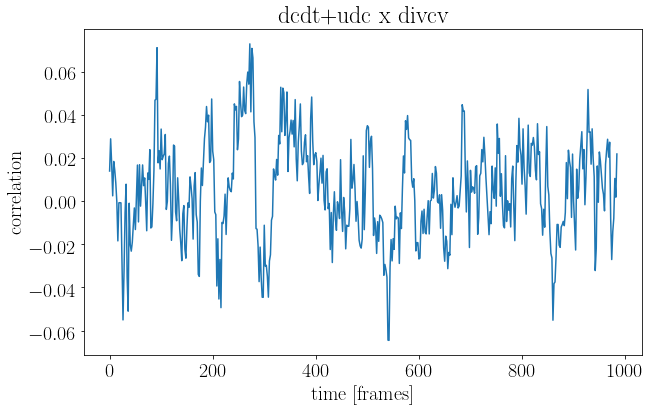

In [10]:
plt.plot(t, corrL)
plt.xlabel('time [frames]')
plt.ylabel('correlation')
plt.title(r'dcdt+udc x divcv')

In [18]:
np.array(corrL).mean()

0.005292729235011068

In [24]:
%%time
folder_dcadv = r'E:\moreData\02042020\dc_adv\80-1'
folder_img = r'E:\moreData\02042020\80-1\8-bit'
folder_piv = r'E:\moreData\02042020\piv_result_50\80-1'
folder_list = next(os.walk(folder_dcadv))[1]
dt = []
corrL = []

for s in folder_list:   
    folder = os.path.join(folder_dcadv, s)
    l = cl.readdata(folder)
    corr = 0
    k = 0
    m = 0
    for num, i in l.iterrows():
        if num % 50 != 0:
            continue
        name = i.Name.split('-')[0]
        n0 = int(name)
        advData = pd.read_csv(i.Dir)
        img = io.imread(os.path.join(folder_img, name + '.tif'))
        pivData = pd.read_csv(os.path.join(folder_piv, '{:04d}-{:04d}.csv'.format(n0, n0+1)))
        c, v, divcn, divcv, divv = cl.div_field(img, pivData, 50, 25)
#         advData.adv = advData.adv - advData.dc/10 + advData.dc*3
        adv = np.array(advData.adv).reshape(divv.shape)
        corr += ((divv - divv.mean())*(adv - adv.mean())).mean() / divv.std() / adv.std()
        k += 1
    corr /= k
    dt.append(int(s.split('=')[1]))
    corrL.append(corr)
data = pd.DataFrame().assign(dt=dt, corr=corrL)
data.to_csv(r'E:\moreData\02042020\dc_adv\80-1\dt_corr.csv', index=False)

Wall time: 41.8 s


In [44]:
folder_piv = r'E:\Zhengyang\06162020\piv_result_50\80-1'
pivData = pd.read_csv(os.path.join(folder_piv, '0100-0101.csv'))

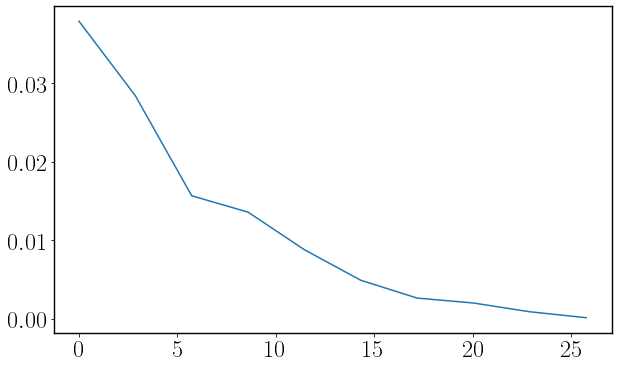

In [45]:
hist, bin_edges = np.histogram(abs(pivData.u), density=True)
plt.plot(bin_edges[:-1]*0.33, hist)

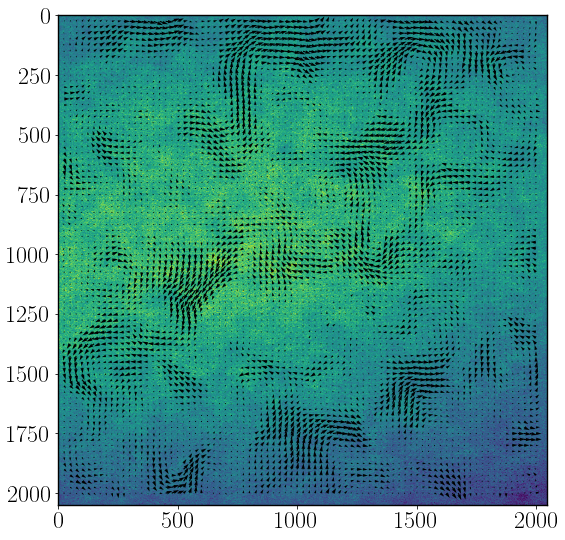

In [48]:
folder_img = r'G:\Wei\02042020\80-1\8-bit'
plt.figure(figsize=(9, 9))
plt.imshow(io.imread(os.path.join(folder_img, '0100.tif')))
plt.quiver(pivData.x, pivData.y, pivData.u, pivData.v)

In [49]:
pivData

,x,y,u,v
0,25.0,25.0,4.148941,11.819426
1,50.0,25.0,9.605249,13.188866
2,75.0,25.0,10.167637,16.110227
3,100.0,25.0,12.477066,19.152577
4,125.0,25.0,17.885066,21.343192
5,150.0,25.0,20.939806,15.252052
6,175.0,25.0,19.914557,15.611189
7,200.0,25.0,14.680938,10.754937
8,225.0,25.0,25.556077,7.140696
9,250.0,25.0,29.957511,6.522862


In [11]:
numL = []
for s in folder_list:
    folder = os.path.join(folder_dcadv, s)
    l = cl.readdata(folder)
    num_file = len(l)
    numL.append(num_file)

In [13]:
dt = [5, 10, 15]

In [14]:
corr = [0.002, 0.026, 0.005]

In [12]:
corrL = np.array(corrL) / np.array(numL)

In [14]:
numL

[495, 495, 494, 494, 493, 493, 498, 497, 497, 496, 496]

In [ ]:
plt.plot(dt, corrL, marker='o', ls='', markersize=10)
plt.xlabel('$\Delta t$')
plt.ylabel('correlation')

Text(0, 0.5, 'correlation')

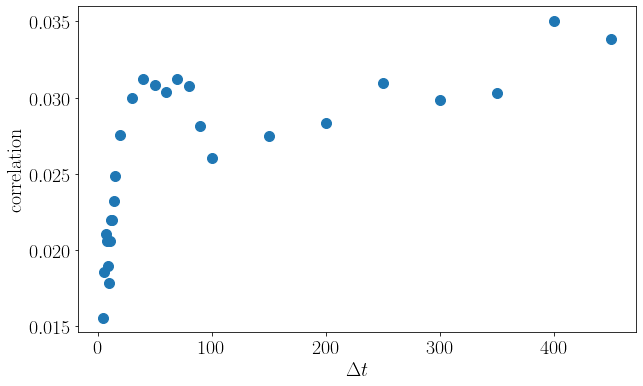

In [25]:
data = pd.read_csv(r'E:\moreData\02042020\dc_adv\80-1\dt_corr.csv')
plt.plot(data.dt, data['corr'], marker='o', ls='', markersize=10)
plt.xlabel('$\Delta t$')
plt.ylabel('correlation')

## example code for plotting correlation data with varying $\Delta t$

In [26]:
# implemented as div_x_dcadv.py
folder_div = r'I:\Github\Python\Correlation\test_images\divvXdcadv\div'
folder_dcadv = r'I:\Github\Python\Correlation\test_images\divvXdcadv\dcadv'
folder_out = r'I:\Github\Python\Correlation\test_images\divvXdcadv\result'
folder_list_dt = next(os.walk(folder_dcadv))[1]

adv_divvL = [] # dcadv X divv
adv_divcvL = [] # dcadv X divcv
dc_divvL = [] # dc X divv
dc_divcvL = [] # dc X divcv
dtL = [] # Delta t
for s in folder_list_dt:
    dt = int(s.split('=')[1])
    folder = os.path.join(folder_dcadv, s)
    l = cl.readdata(folder)
    count = 0
    adv_divv = 0
    adv_divcv = 0
    dc_divv = 0
    dc_divcv = 0
    for num, i in l.iterrows():
        f, file = os.path.split(i.Dir)
        name = file.split('-')[0]
        n0 = int(name)
        n1 = n0 + 1
        divDir = os.path.join(folder_div, '{0:04d}-{1:04d}.csv'.format(n0, n1))
        divData = pd.read_csv(divDir)
        divv = divData['divv']
        divcv = divData['divcv']
        advData = pd.read_csv(i.Dir)
        adv = advData['adv']
        dc = advData['dc']
        adv_divv += ((divv - divv.mean())*(adv - adv.mean())).mean() / divv.std() / adv.std()
        adv_divcv += ((divcv - divv.mean())*(adv - adv.mean())).mean() / divcv.std() / adv.std()
        dc_divv += ((divv - divv.mean())*(dc - dc.mean())).mean() / divv.std() / dc.std()
        dc_divcv += ((divv - divcv.mean())*(dc - dc.mean())).mean() / divcv.std() / dc.std()
        count += 1
    adv_divv /= count
    adv_divcv /= count
    dc_divv /= count
    dc_divcv /= count
    adv_divvL.append(adv_divv)
    adv_divcvL.append(adv_divcv)
    dc_divvL.append(dc_divv)
    dc_divcvL.append(dc_divcv)
    dtL.append(dt)
data = pd.DataFrame().assign(dt=dtL, adv_divv=corr_divvL, adv_divcv=corr_divcvL, dc_divv=dc_divvL, dc_divcv=dc_divcvL)
data.to_csv(os.path.join(folder_out, 'divvXdcadv.csv'), index=False)

In [4]:
name = '80-1'
folder = r'E:\moreData\02042020\divXdcadv\{}'.format(name) 
folder_out = r'E:\moreData\02042020\divXdcadv\visualize'
data = pd.read_csv(os.path.join(folder, 'divvXdcadv.csv'))

Text(0, 0.5, 'correlation')

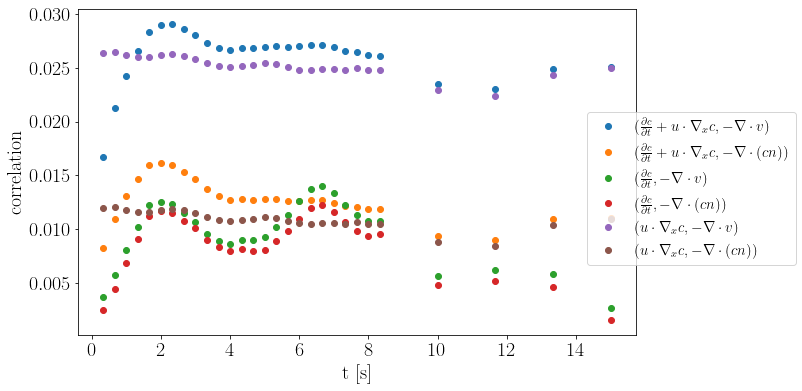

In [5]:
plt.plot(data.dt/30, data['adv_divv'], ls='', marker='o', label=r'$(\frac{\partial c}{\partial t}+u\cdot \nabla_xc, -\nabla\cdot v)$')
plt.plot(data.dt/30, data['adv_divcv'], ls='', marker='o', label=r'$(\frac{\partial c}{\partial t}+u\cdot \nabla_xc, -\nabla\cdot(cn))$')
plt.plot(data.dt/30, data['dc_divv'], ls='', marker='o', label=r'$(\frac{\partial c}{\partial t}, -\nabla\cdot v)$')
plt.plot(data.dt/30, data['dc_divcv'], ls='', marker='o', label=r'$(\frac{\partial c}{\partial t}, -\nabla\cdot(cn))$')
plt.plot(data.dt/30, data['vdc_divv'], ls='', marker='o', label=r'$(u\cdot \nabla_xc, -\nabla\cdot v)$')
plt.plot(data.dt/30, data['vdc_divcv'], ls='', marker='o', label=r'$(u\cdot \nabla_xc, -\nabla\cdot(cn))$')
plt.legend(loc=5, bbox_to_anchor=(0.8, 0.2, 0.5, 0.5), fontsize=15)
plt.xlabel('t [s]')
plt.ylabel('correlation')
# plt.tight_layout()
# plt.savefig(os.path.join(folder_out, name + '.png'), fmt='png', dpi=300)

In [90]:
names = []
conc = [20, 40, 60, 80]
num = [1, 2, 3]
for c in conc:
    for n in num:
        name = '{0:d}-{1:d}'.format(c, n)
        names.append(name)

In [91]:
folder_out = r'E:\Zhengyang\02042020\divXdcadv\visualize'
for name in names:
    folder = r'E:\Zhengyang\02042020\divXdcadv\{}'.format(name)
    data = pd.read_csv(os.path.join(folder, 'divvXdcadv.csv'))
    plt.plot(data.dt/30, data['adv_divv'], ls='', marker='o', label=r'$(\frac{\partial c}{\partial t}+u\cdot \nabla_xc, \nabla\cdot v)$')
    plt.plot(data.dt/30, data['adv_divcv'], ls='', marker='o', label=r'$(\frac{\partial c}{\partial t}+u\cdot \nabla_xc, -\nabla\cdot(cn))$')
    plt.plot(data.dt/30, data['dc_divv'], ls='', marker='o', label=r'$(\frac{\partial c}{\partial t}, \nabla\cdot v)$')
    plt.plot(data.dt/30, data['dc_divcv'], ls='', marker='o', label=r'$(\frac{\partial c}{\partial t}, -\nabla\cdot(cn))$')
    plt.legend(loc=5, bbox_to_anchor=(0.8, 0.2, 0.5, 0.5), fontsize=10)
    plt.xlabel('t [s]')
    plt.ylabel('correlation')
    plt.tight_layout()
    plt.savefig(os.path.join(folder_out, name + '.png'), fmt='png', dpi=300)
    plt.clf()

<Figure size 720x432 with 0 Axes>

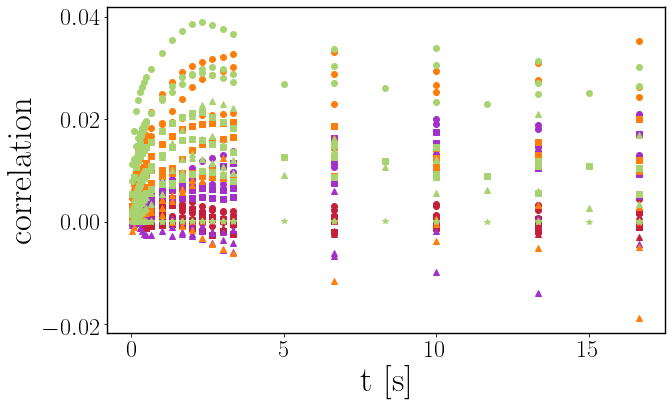

In [95]:
# all in one
# folder_out = r'E:\Zhengyang\02042020\divXdcadv\visualize'
count = 0
for c in conc:
    color = mil.wowcolor(count)
    count += 1
    for n in num:
        name = '{0:d}-{1:d}'.format(c, n)
        folder = r'E:\Zhengyang\02042020\divXdcadv\{}'.format(name)
        data = pd.read_csv(os.path.join(folder, 'divvXdcadv.csv'))
        plt.plot(data.dt/30, data['adv_divv'], ls='', marker='o', color=color, label=r'$(\frac{\partial c}{\partial t}+u\cdot \nabla_xc, \nabla\cdot v)$')
        plt.plot(data.dt/30, data['adv_divcv'], ls='', marker='s', color=color, label=r'$(\frac{\partial c}{\partial t}+u\cdot \nabla_xc, -\nabla\cdot(cn))$')
        plt.plot(data.dt/30, data['dc_divv'], ls='', marker='^', color=color, label=r'$(\frac{\partial c}{\partial t}, \nabla\cdot v)$')
        plt.plot(data.dt/30, data['dc_divcv'], ls='', marker='*', color=color, label=r'$(\frac{\partial c}{\partial t}, -\nabla\cdot(cn))$')
#         plt.legend(loc=5, bbox_to_anchor=(0.8, 0.2, 0.5, 0.5), fontsize=10)
        plt.xlabel('t [s]')
        plt.ylabel('correlation')
#     plt.tight_layout()
#     plt.savefig(os.path.join(folder_out, name + '.png'), fmt='png', dpi=300)
#     plt.clf()

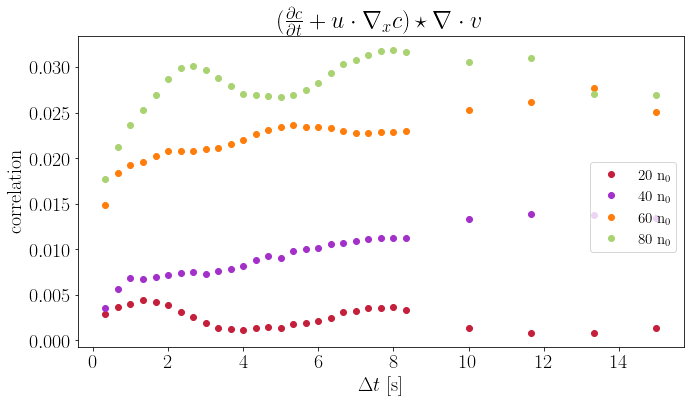

In [11]:
# look at one quantity div x dcadv
count = 0
n = 3
conc = [20, 40, 60, 80]
for c in conc:
    color = mil.wowcolor(count)
    count += 1    
    name = '{0:d}-{1:d}'.format(c, n)
    folder = r'E:\moreData\02042020\divXdcadv\{}'.format(name)
    data = pd.read_csv(os.path.join(folder, 'divvXdcadv.csv'))
    plt.plot(data.dt/30, data['adv_divv'], ls='', marker='o', color=color, label='{} n$_0$'.format(c))
plt.xlabel('$\Delta t$ [s]')
plt.ylabel('correlation')
plt.title(r'$(\frac{\partial c}{\partial t}+u\cdot \nabla_xc)\star \nabla\cdot v$')
plt.legend(loc=5, bbox_to_anchor=(0.5, 0.2, 0.5, 0.5), fontsize=15)
plt.tight_layout()
# plt.savefig(os.path.join(folder_out, 'sample_{0}.png'.format(n)), fmt='png', dpi=300)

<font color='red'><b>Comment to myself: </b></font> This notebook is still highly unorganized. Whenever possible, clean it up.

## Fix $\Delta t$ and plot correlation as a function of concentration

### 1. $\frac{\partial c}{\partial t} \star \nabla\cdot v$

Here, I only plot the correlation between $\frac{\partial c}{\partial t}$ and $\nabla\cdot v$, since I'm not clear how $u\cdot \nabla_xc$ should be interpreted. In an ordinary flow, advection is one of the causes that changes local density, if compressible. 

In [21]:
fps = 30
conc = [20, 40, 60, 80]
avg = []
std = []
num = [1, 2, 3]
t = 2 * fps
for c in conc:    
    temp = []
    for n in num:
        name = '{0}-{1}'.format(c, n)
        folder = r'E:\moreData\02042020\divXdcadv\{}'.format(name)
        data = pd.read_csv(os.path.join(folder, 'divvXdcadv.csv'))
        temp.append(data['dc_divv'].loc[data['dt']==t].values[0])
    temp = np.array(temp)
    avg.append(temp.mean())
    std.append(temp.std())

Text(0, 0.5, '$\\dot c \\star div(v)$')

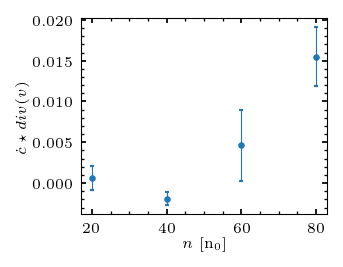

In [34]:
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.errorbar(conc, avg, yerr=std, marker='o', markersize=2, capsize=1, lw=0, elinewidth=0.5, color=mil.bestcolor(0))
ax.set_xlabel('$n$ [n$_0$]')
ax.set_ylabel(r'$\dot c \star div(v)$')

### 2. $\frac{\partial c}{\partial t} + u\cdot \nabla_xc \star \nabla\cdot v$

In [35]:
fps = 30
conc = [20, 40, 60, 80]
avg = []
std = []
num = [1, 2, 3]
t = 2 * fps
for c in conc:    
    temp = []
    for n in num:
        name = '{0}-{1}'.format(c, n)
        folder = r'E:\moreData\02042020\divXdcadv\{}'.format(name)
        data = pd.read_csv(os.path.join(folder, 'divvXdcadv.csv'))
        temp.append(data['adv_divv'].loc[data['dt']==t].values[0])
    temp = np.array(temp)
    avg.append(temp.mean())
    std.append(temp.std())

Text(0, 0.5, '$\\dot c + u\\cdot \\nabla_xc \\star div(v)$')

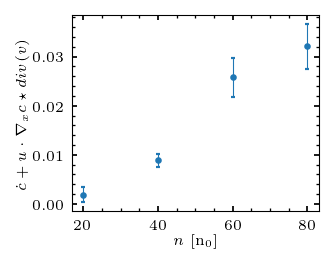

In [37]:
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.errorbar(conc, avg, yerr=std, marker='o', markersize=2, capsize=1, lw=0, elinewidth=0.5, color=mil.bestcolor(0))
ax.set_xlabel('$n$ [n$_0$]')
ax.set_ylabel(r'$\dot c + u\cdot \nabla_xc \star div(v)$')

### 3. $ u\cdot \nabla_xc \star \nabla\cdot v$

In [38]:
fps = 30
conc = [20, 40, 60, 80]
avg = []
std = []
num = [1, 2, 3]
t = 2 * fps
for c in conc:    
    temp = []
    for n in num:
        name = '{0}-{1}'.format(c, n)
        folder = r'E:\moreData\02042020\divXdcadv\{}'.format(name)
        data = pd.read_csv(os.path.join(folder, 'divvXdcadv.csv'))
        temp.append(data['vdc_divv'].loc[data['dt']==t].values[0])
    temp = np.array(temp)
    avg.append(temp.mean())
    std.append(temp.std())

Text(0, 0.5, '$ u\\cdot \\nabla_xc \\star div(v)$')

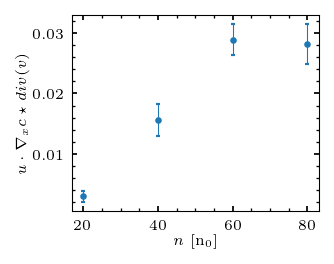

In [39]:
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.errorbar(conc, avg, yerr=std, marker='o', markersize=2, capsize=1, lw=0, elinewidth=0.5, color=mil.bestcolor(0))
ax.set_xlabel('$n$ [n$_0$]')
ax.set_ylabel(r'$ u\cdot \nabla_xc \star div(v)$')